In [ ]:
pip install matplotlib wordcloud pandas nltk

In [ ]:
import pandas as pd
import os

folder_path = '/content/movie'  # 업로드한 파일들이 저장된 폴더 경로로 수정
file_list = os.listdir(folder_path)

# 파일 읽기 및 처리
for file_name in file_list:
    file_path = os.path.join(folder_path, file_name)
    if file_name.endswith('.tsv'):  # 예를 들어 CSV 파일만 처리하도록 조건을 추가
        data = pd.read_csv(file_path, sep='\t')
        print(f"File: {file_name}")
        print(data.head())  # 데이터 확인
        print("=" * 50)


File: testData.tsv
         id                                             review
0  12311_10  Naturally in a film who's main themes are of m...
1    8348_2  This movie is a disaster within a disaster fil...
2    5828_4  All in all, this is a movie for kids. We saw i...
3    7186_2  Afraid of the Dark left me with the impression...
4   12128_7  A very accurate depiction of small time mob li...
File: unlabeledTrainData.tsv
        id                                             review
0   9999_0  Watching Time Chasers, it obvious that it was ...
1  45057_0  I saw this film about 20 years ago and remembe...
2  15561_0  Minor Spoilers<br /><br />In New York, Joan Ba...
3   7161_0  I went to see this film with a great deal of e...
4  43971_0  Yes, I agree with everyone on this site this m...
File: labeledTrainData.tsv
       id  sentiment                                             review
0  5814_8          1  With all this stuff going down at the moment w...
1  2381_9          1  \The Clas

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


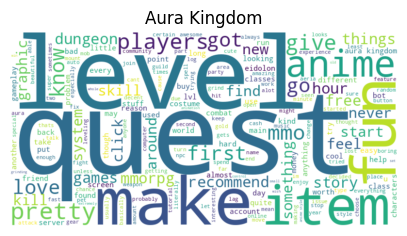

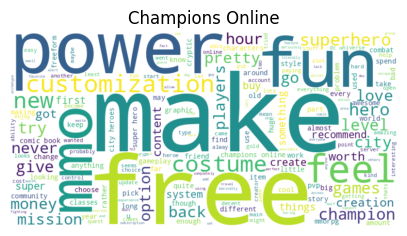

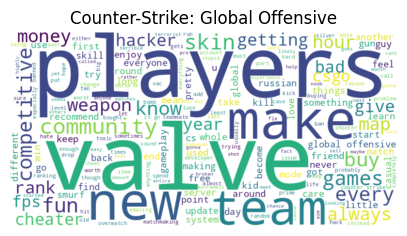

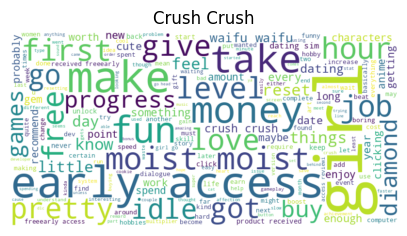

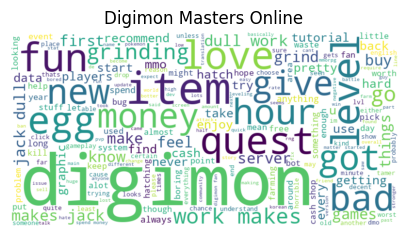

...

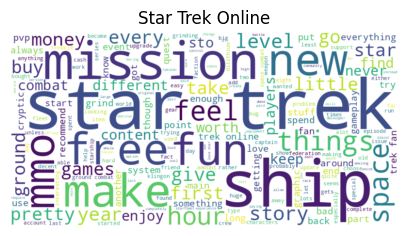

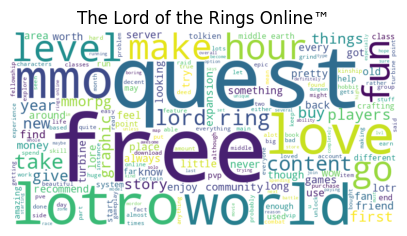

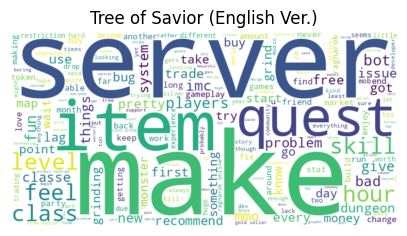

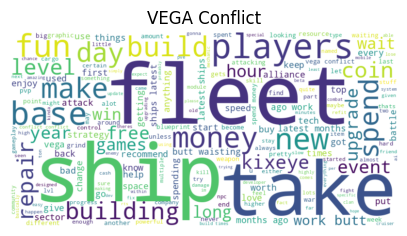

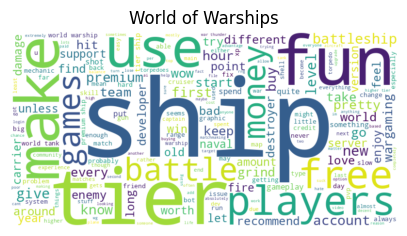

In [ ]:
## 게임 워드클라우드
import pandas as pd
import matplotlib.pyplot as plt
from wordcloud import WordCloud
import nltk
from nltk.corpus import stopwords
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics.pairwise import cosine_similarity

# nltk의 불용어(stopwords)를 다운로드합니다.
nltk.download('stopwords')

# CSV 파일에서 데이터를 불러옵니다. 파일 경로와 열 이름을 적절하게 수정하세요.
df1 = pd.read_csv('/content/game/test.csv')

# 열 이름 출력
df1.columns

# 열 이름 한국어로 변경
df1.rename(columns={"title":"게임_제목", "user_review":"리뷰_텍스트"}, inplace=True)

# 불필요한 열 삭제하기
df1.drop(['review_id', 'year'], axis = 'columns', inplace=True)

df1

# 게임 제목을 기준으로 리뷰 데이터를 합칩니다.
merged_data = df1.groupby('게임_제목')['리뷰_텍스트'].apply(lambda x: ' '.join(x)).reset_index()

# 불용어를 제거합니다.
stop_words = set(stopwords.words('english'))
merged_data['리뷰_텍스트'] = merged_data['리뷰_텍스트'].apply(lambda x: ' '.join([word.lower() for word in x.split() if word.isalpha() and word.lower() not in stop_words]))

# 사용자 정의 불용어 목록 (불용어 추가하려면 여기에 추가하세요!)
custom_stopwords = ["game", "play", "character", "people", "gg", "really", "great", "time", "playing", "one",
                    "time", "dont", "good", "best", "thing", "played", "come", "well", "think", "need", "yes",
                    "right", "nice", "way", "going", "thank", "real", "made", "less", "sometime", "better",
                    "nothing", "without", "full", 'tell', "clicker", 'added', "already", "review", "see", "many",
                    "look", "lot", "want", "player", "pay","still", "even", "bit", "steam", "without", "actually",
                    "thing", "played", "come", "well", "think", "need", "yes", "right", "nice", "way", "going",
                    "thank", "real", "made", "less", "sometime", "better", "say", "seem", "much"]

# 게임 제목을 기준으로 워드클라우드를 생성합니다.
for index, row in merged_data.iterrows():
    game_title = row['게임_제목']
    review_text = row['리뷰_텍스트']

    # 사용자 정의 불용어를 제거합니다.
    review_text = ' '.join([word for word in review_text.split() if word not in custom_stopwords])

    # 워드클라우드 생성
    wordcloud = WordCloud(width=800, height=400, background_color='white').generate(review_text)

    # 워드클라우드를 시각화하고 저장합니다.
    plt.figure(figsize=(5, 5))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.title(game_title)
    plt.axis('off')
    plt.savefig(f'{game_title}_wordcloud.png')
    plt.show()

# TF-IDF 벡터화
tfidf_vectorizer = TfidfVectorizer()
tfidf_matrix = tfidf_vectorizer.fit_transform(merged_data['리뷰_텍스트'])

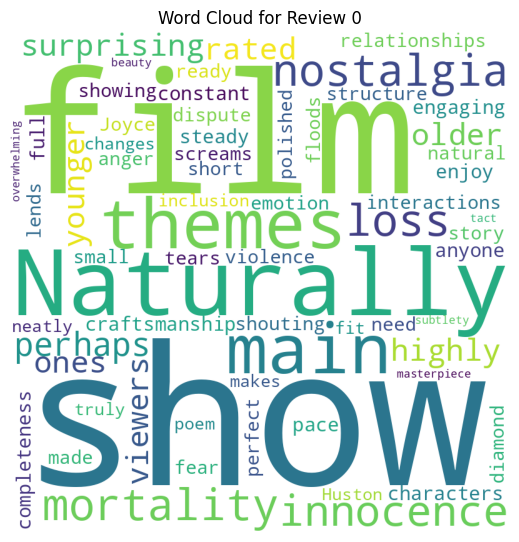

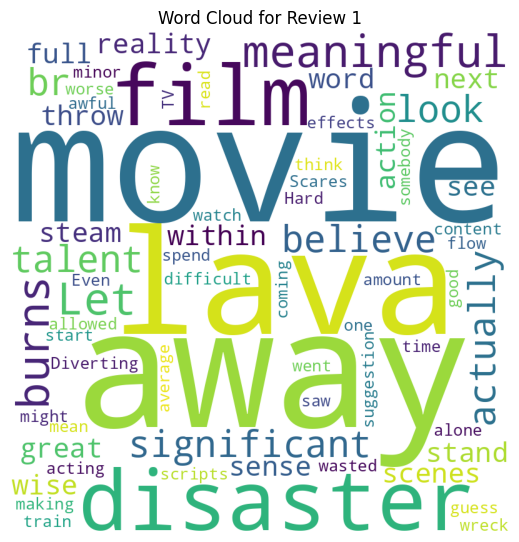

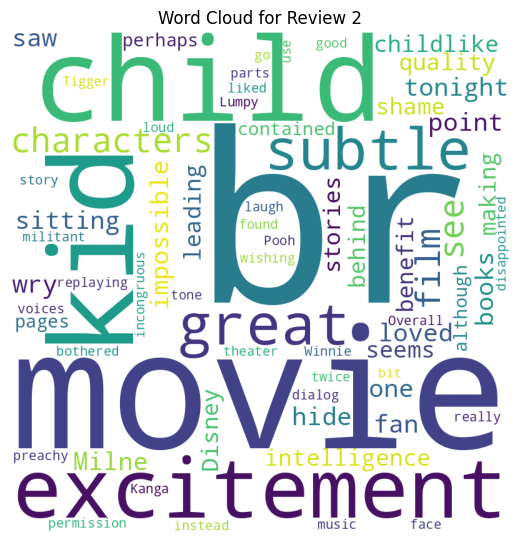

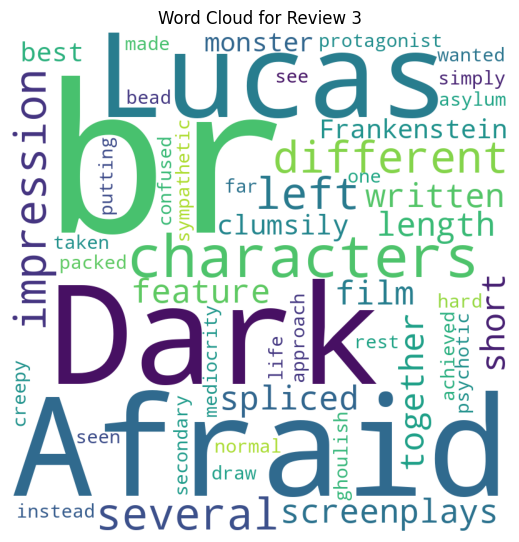

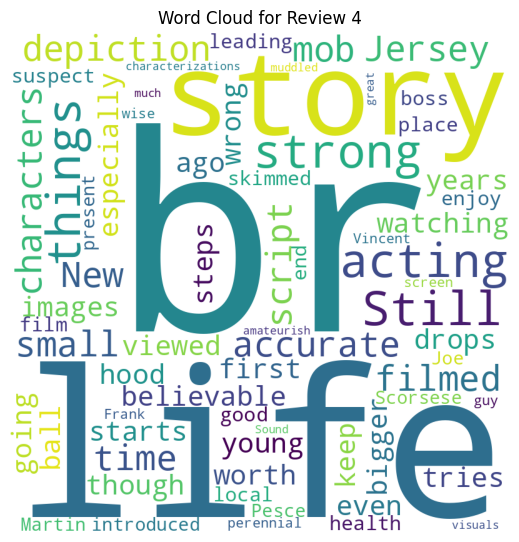

...

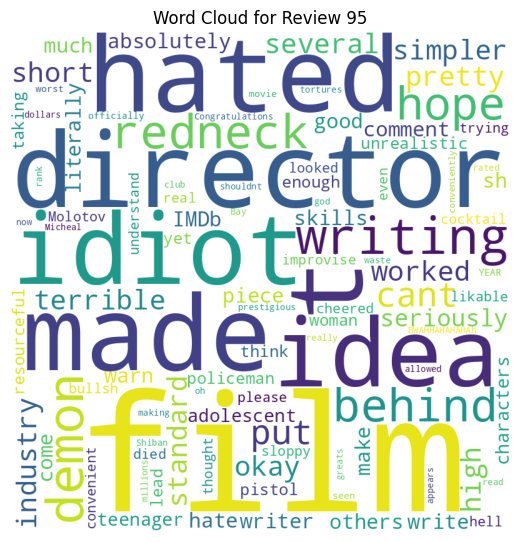

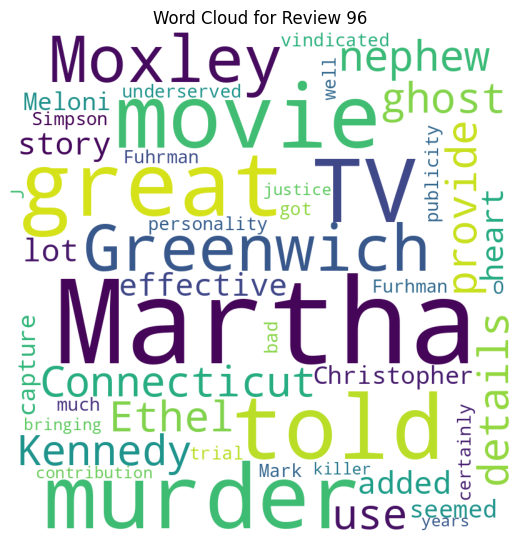

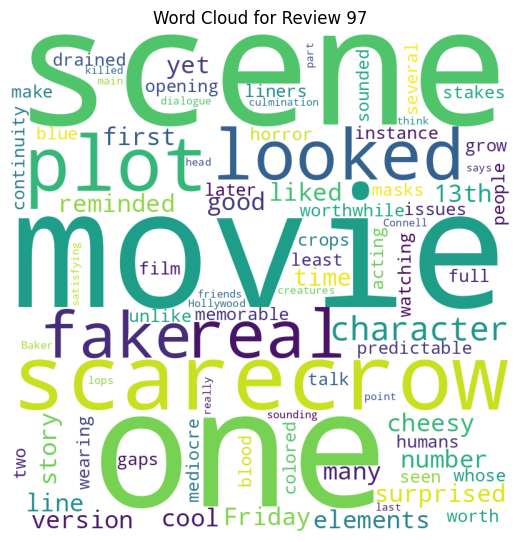

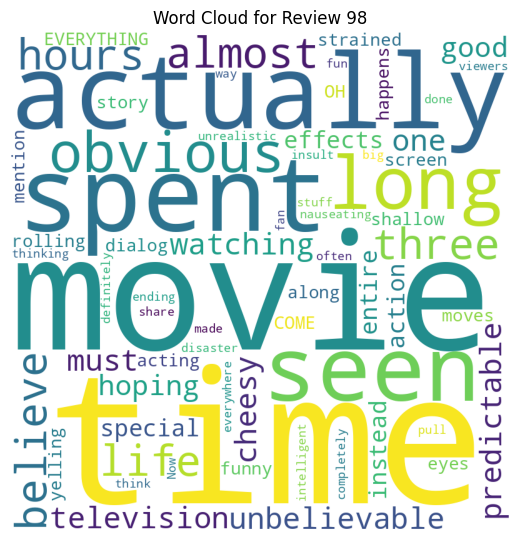

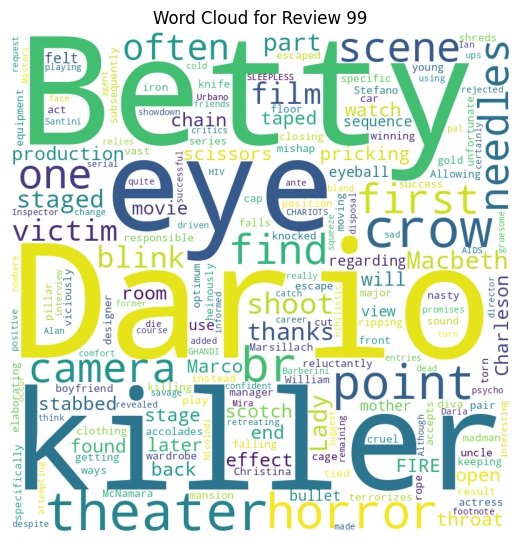

In [ ]:
##영화 워드클라우드
import pandas as pd
from wordcloud import WordCloud
import matplotlib.pyplot as plt

# 파일 경로
file_path = '/content/movie/testData.tsv'  # 파일 경로로 수정

# 파일 읽기 (첫 100행만 읽어오기)
data = pd.read_csv(file_path, sep='\t', nrows=100)

# 워드 클라우드 생성 함수
def create_wordcloud(text):
    wordcloud = WordCloud(width=800, height=800,
                          background_color='white',
                          min_font_size=10).generate(text)
    return wordcloud

# 각 행(리뷰) 별로 워드 클라우드 생성 및 출력
for index, row in data.iterrows():
    review = row['review']

    # 워드 클라우드 생성
    wordcloud = create_wordcloud(review)

    # 워드 클라우드 출력
    plt.figure(figsize=(5, 5), facecolor=None)
    plt.imshow(wordcloud)
    plt.axis("off")
    plt.tight_layout(pad=0)
    plt.title(f"Word Cloud for Review {index}")
    plt.show()

# TF-IDF 벡터화
tfidf_vectorizer = TfidfVectorizer()
tfidf_matrix = tfidf_vectorizer.fit_transform(movie_data['review'])

In [ ]:
##게임-게임
import pandas as pd
import matplotlib.pyplot as plt
from wordcloud import WordCloud
import nltk
from nltk.corpus import stopwords
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics.pairwise import cosine_similarity

# CSV 파일에서 데이터를 불러옵니다. 파일 경로와 열 이름을 적절하게 수정하세요.
df1 = pd.read_csv('/content/game/test.csv')

# 열 이름 출력
df1.columns

# 열 이름 한국어로 변경
df1.rename(columns={"title":"게임_제목", "user_review":"리뷰_텍스트"}, inplace=True)

# 불필요한 열 삭제하기
df1.drop(['review_id', 'year'], axis = 'columns', inplace=True)

df1

# 게임 제목을 기준으로 리뷰 데이터를 합칩니다.
merged_data = df1.groupby('게임_제목')['리뷰_텍스트'].apply(lambda x: ' '.join(x)).reset_index()

# TF-IDF 벡터화
tfidf_vectorizer = TfidfVectorizer()
tfidf_matrix = tfidf_vectorizer.fit_transform(merged_data['리뷰_텍스트'])

# 사용자로부터 키워드 입력 받기
user_keyword = input("유사한 워드클라우드를 찾을 키워드를 입력하세요: ")

# 입력된 키워드에 대한 TF-IDF 벡터 계산
user_keyword_tfidf = tfidf_vectorizer.transform([user_keyword])

# 코사인 유사도 계산
cosine_sim = cosine_similarity(user_keyword_tfidf, tfidf_matrix)

# 코사인 유사도를 내림차순으로 정렬
similar_wordcloud_indices = cosine_sim.argsort()[0][::-1]

# 2위와 마지막 순위의 유사한 워드클라우드 목록 생성
second_similar_wordcloud = merged_data['게임_제목'].loc[similar_wordcloud_indices[1]]
last_similar_wordcloud = merged_data['게임_제목'].loc[similar_wordcloud_indices[-1]]

# 결과 출력
print(f"{user_keyword}와(과) 유사한 게임 2위: {second_similar_wordcloud}")
print(f"{user_keyword}와(과) 유사한 게임 마지막 순위: {last_similar_wordcloud}")

유사한 워드클라우드를 찾을 키워드를 입력하세요: digimon
digimon와(과) 유사한 게임 2위: Aura Kingdom
digimon와(과) 유사한 게임 마지막 순위: H1Z1


In [ ]:
# 영화-게임
import pandas as pd
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics.pairwise import cosine_similarity
from wordcloud import WordCloud
import matplotlib.pyplot as plt

# 데이터 경로 설정
movie_data_path = '/content/movie/testData.tsv'  # 수정 필요
game_data_path = '/content/game/train.csv'    # 수정 필요

# 데이터 불러오기
movie_data = pd.read_csv(movie_data_path, delimiter='\t', nrows=10000)
game_data = pd.read_csv(game_data_path, nrows=10000)

# TF-IDF 벡터화
tfidf_vectorizer = TfidfVectorizer()
movie_tfidf_matrix = tfidf_vectorizer.fit_transform(movie_data['review'])
game_tfidf_matrix = tfidf_vectorizer.transform(game_data['user_review'])

# 사용자에게 영화 ID 입력 받기
movie_id = int(input("영화 ID를 입력하세요: "))  # 영화 ID는 0부터 시작

# 선택한 영화의 리뷰 데이터 추출
selected_movie_vector = movie_tfidf_matrix[movie_id]

# 코사인 유사도 계산
cosine_similarities = cosine_similarity(selected_movie_vector, game_tfidf_matrix)

# 유사도가 높은 순으로 게임을 나열
similar_games = []
for i, similarity in enumerate(cosine_similarities[0]):
  similar_games.append((i, similarity))

similar_games.sort(key=lambda x: x[1], reverse=True)

# 추천 결과 출력
recommendation_count = 0
previous_game_title = None
for game_index, similarity in similar_games:
    if recommendation_count >= 2:  # 유사한 게임 2개까지만 출력
        break
    game_title = game_data.iloc[game_index]['title']
    if game_title != previous_game_title:  # 이전 게임과 제목이 겹치지 않는 경우에만 출력
        print(f"추천 게임 {recommendation_count + 1}:{game_title}")
        recommendation_count += 1
        previous_game_title = game_title

영화 ID를 입력하세요: 5
추천 게임 1:Heroes & Generals
추천 게임 2:PlanetSide 2
